In [1]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [ ]:
# !unzip '/content/drive/MyDrive/archive.zip' -d '/content/drive/MyDrive/car_original/'

In [2]:
from PIL import Image, ImageFilter
import os
import tensorflow as tf 
import time 
from matplotlib import pyplot as plt 
from IPython import display
import numpy as np
import random
import tqdm
import math
from scipy.linalg import sqrtm

tf.config.run_functions_eagerly(True)
drive_dir = '/content/drive/MyDrive/'
original_dir = drive_dir + 'car_original/'
edge_dir = drive_dir + 'car_edge/'

original_test_dir = drive_dir + 'car_original_test/'
edge_test_dir = drive_dir + 'car_edge_test/'

# files = os.listdir(original_dir)
# print(len(files))

In [3]:
BUFFER_SIZE = 400
BATCH_SIZE = 1
IMG_WIDTH = 256
IMG_HEIGHT = 256

In [4]:
tmp_test_original = os.listdir(original_test_dir)
print(len(tmp_test_original))

tmp_test_edge = os.listdir(edge_test_dir)
print(len(tmp_test_edge))

1000
1000


In [11]:
tmp_original = os.listdir(original_dir)
print(len(tmp_original))

tmp_edge = os.listdir(edge_dir)
print(len(tmp_edge))

63467
63467


In [8]:
def load(image_name):
  image_name = tf.strings.split(image_name, os.sep)[-1]
  
  # image_name = image_name.numpy().decode('utf-8')
  # print(image_name)

  edge = tf.io.read_file(edge_dir + image_name)
  edge = tf.image.decode_jpeg(edge)

  original = tf.io.read_file(original_dir + image_name)
  original = tf.image.decode_jpeg(original)

  input_image = tf.cast(edge, tf.float32)
  real_image = tf.cast(original, tf.float32)
  # print(input_image.shape)
  # print(real_image.shape)
  return input_image, real_image

In [9]:
def load_test(image_name):
  image_name = tf.strings.split(image_name, os.sep)[-1]

  edge = tf.io.read_file(edge_test_dir + image_name)
  edge = tf.image.decode_jpeg(edge)

  original = tf.io.read_file(original_test_dir + image_name)
  original = tf.image.decode_jpeg(original)

  input_image = tf.cast(edge, tf.float32)
  real_image = tf.cast(original, tf.float32)
  # print(input_image.shape)
  # print(real_image.shape)
  return input_image, real_image

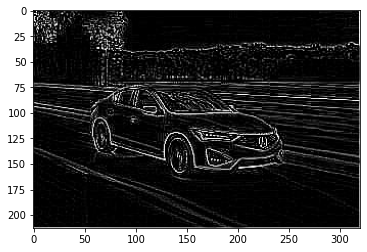

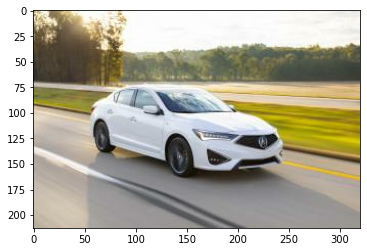

In [12]:
inp, re = load(original_dir + 'Acura_ILX_2019_25_17_200_24_4_70_55_182_24_FWD_5_4_4dr_cca.jpg')
plt.figure()
plt.imshow(inp / 255.0)
plt.figure()
plt.imshow(re / 255.0)

In [13]:
def resize(input_image, real_image, height, width):
  input_image = tf.image.resize_with_pad(input_image, height, width)
  real_image = tf.image.resize_with_pad(real_image, height, width)

  return input_image, real_image

In [14]:
def random_crop(input_image, real_image):
  stacked_image = tf.stack([input_image, real_image], axis=0)
  cropped_image = tf.image.random_crop(stacked_image, size=[2, IMG_HEIGHT, IMG_WIDTH, 3])

  return cropped_image[0], cropped_image[1]

In [15]:
# normalizing the images to [-1, 1]
def normalize(input_image, real_image):
  input_image = (input_image / 127.5) - 1
  real_image = (real_image / 127.5) - 1
  
  return input_image, real_image

In [16]:
@tf.function()
def random_jitter(input_image, real_image):
  # resizing to 320 * 320 * 3
  input_image, real_image = resize(input_image, real_image, 320, 320)

  # randomly cropping to 256 * 256 * 3
  input_image, real_image = random_crop(input_image, real_image)

  if random.random() > 0.5:
    # random mirroring
    input_image = tf.image.flip_left_right(input_image)
    real_image = tf.image.flip_left_right(real_image)

  return input_image, real_image 


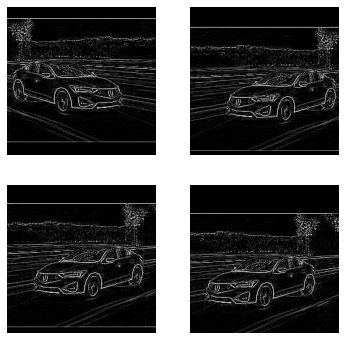

In [17]:
plt.figure(figsize=(6, 6))
for i in range(4):
  rj_inp, rj_re = random_jitter(inp, re)
  plt.subplot(2, 2, i+1)
  plt.imshow(rj_inp / 255.0)
  plt.axis('off')
plt.show()

In [18]:
@tf.function
def load_image_train(image_name):
  input_image, real_image = load(image_name)
  input_image, real_image = random_jitter(input_image, real_image)
  input_image, real_image = normalize(input_image, real_image)

  return input_image, real_image

In [19]:
@tf.function
def load_image_test(image_name):
  input_image, real_image = load_test(image_name)
  input_image, real_image = resize(input_image, real_image, IMG_HEIGHT, IMG_WIDTH)
  input_image, real_image = normalize(input_image, real_image)

  return input_image, real_image

In [20]:
def downsample(filters, size, apply_batchnorm=True):
  initializer = tf.random_normal_initializer(0.0, 0.02)
  result = tf.keras.Sequential()
  result.add(
      tf.keras.layers.Conv2D(filters, size, strides=2, padding='same', kernel_initializer=initializer, use_bias=False)
  )
  if apply_batchnorm:
    result.add(tf.keras.layers.BatchNormalization())

  result.add(tf.keras.layers.LeakyReLU())
  return result

In [21]:
def inception(x, filters_1x1, filters_3x3_reduce, filters_3x3, filters_5x5_reduce, filters_5x5, filters_pool, initializer):
  path1 = tf.keras.layers.Conv2D(filters_1x1, (1, 1), strides=2, padding='same', activation=tf.keras.layers.LeakyReLU(), kernel_initializer=initializer)(x)

  path2 = tf.keras.layers.Conv2D(filters_3x3_reduce, (3, 3), padding='same', activation=tf.keras.layers.LeakyReLU(), kernel_initializer=initializer)(x)
  path2 = tf.keras.layers.Conv2D(filters_3x3, (3, 3), strides=2, padding='same', activation=tf.keras.layers.LeakyReLU(), kernel_initializer=initializer)(path2)

  path3 = tf.keras.layers.Conv2D(filters_5x5_reduce, (5, 5), padding='same', activation=tf.keras.layers.LeakyReLU(), kernel_initializer=initializer)(x)
  path3 = tf.keras.layers.Conv2D(filters_5x5, (5, 5), strides=2, padding='same', activation=tf.keras.layers.LeakyReLU(), kernel_initializer=initializer)(path3)
  

  path4 = tf.keras.layers.MaxPool2D((3, 3), strides=(1, 1), padding='same')(x)
  path4 = tf.keras.layers.Conv2D(filters_pool, (1, 1), strides=2, padding='same', activation=tf.keras.layers.LeakyReLU(), kernel_initializer=initializer)(path4)

  return tf.concat([path1, path2, path3, path4], axis=3)


In [22]:
def inceptionTranspose(x, filters_1x1, filters_3x3_reduce, filters_3x3, filters_5x5_reduce, filters_5x5, filters_pool, initializer):
  path1 = tf.keras.layers.Conv2DTranspose(filters_1x1, (1, 1), strides=2, padding='same', activation=tf.keras.layers.LeakyReLU(), kernel_initializer=initializer)(x)

  path2 = tf.keras.layers.Conv2DTranspose(filters_3x3_reduce, (3, 3), padding='same', activation=tf.keras.layers.LeakyReLU(), kernel_initializer=initializer)(x)
  path2 = tf.keras.layers.Conv2DTranspose(filters_3x3, (3, 3), strides=2, padding='same', activation=tf.keras.layers.LeakyReLU(), kernel_initializer=initializer)(path2)

  path3 = tf.keras.layers.Conv2DTranspose(filters_5x5_reduce, (5, 5), padding='same', activation=tf.keras.layers.LeakyReLU(), kernel_initializer=initializer)(x)
  path3 = tf.keras.layers.Conv2DTranspose(filters_5x5, (5, 5), strides=2, padding='same', activation=tf.keras.layers.LeakyReLU(), kernel_initializer=initializer)(path3)
  

  path4 = tf.keras.layers.MaxPool2D((3, 3), strides=(1, 1), padding='same')(x)
  path4 = tf.keras.layers.Conv2DTranspose(filters_pool, (1, 1), strides=2, padding='same', activation=tf.keras.layers.LeakyReLU(), kernel_initializer=initializer)(path4)

  return tf.concat([path1, path2, path3, path4], axis=3)


In [23]:
down_model = downsample(3, 4)
down_result = down_model(tf.expand_dims(inp, 0))
print(down_result.shape)

(1, 107, 160, 3)


In [24]:
def upsample(filters, size, apply_dropout=False):
  initializer = tf.random_normal_initializer(0.0, 0.02)
  result = tf.keras.Sequential()
  result.add(
      tf.keras.layers.Conv2DTranspose(filters, size, strides=2, padding='same', kernel_initializer=initializer, use_bias=False)
  )
  result.add(tf.keras.layers.BatchNormalization())
  if apply_dropout:
    result.add(tf.keras.layers.Dropout(0.5))
  result.add(tf.keras.layers.ReLU())
  return result

In [25]:
up_model = upsample(3, 4)
up_result = up_model(down_result)
print(up_result.shape)

(1, 214, 320, 3)


In [26]:
OUTPUT_CHANNELS = 3
def Generator():
  initializer = tf.random_normal_initializer(0.0, 0.02)

  inputs = tf.keras.layers.Input(shape=[IMG_HEIGHT, IMG_WIDTH, 3])

  x = inputs 
  skips = []
  x = inception(x, filters_1x1=64, filters_3x3_reduce=64, filters_3x3=64, filters_5x5_reduce=64, filters_5x5=64, filters_pool=64, initializer=initializer)
  skips.append(x)

  x = inception(x, filters_1x1=64, filters_3x3_reduce=64, filters_3x3=64, filters_5x5_reduce=64, filters_5x5=64, filters_pool=64, initializer=initializer)
  skips.append(x)

  x = inception(x, filters_1x1=128, filters_3x3_reduce=128, filters_3x3=128, filters_5x5_reduce=128, filters_5x5=128, filters_pool=128, initializer=initializer)
  

  x = inceptionTranspose(x, filters_1x1=64, filters_3x3_reduce=64, filters_3x3=64, filters_5x5_reduce=64, filters_5x5=64, filters_pool=64, initializer=initializer)
  x = tf.keras.layers.Concatenate()([x, skips[-1]])

  x = inceptionTranspose(x, filters_1x1=64, filters_3x3_reduce=64, filters_3x3=64, filters_5x5_reduce=64, filters_5x5=64, filters_pool=64, initializer=initializer)
  x = tf.keras.layers.Concatenate()([x, skips[-2]])

  last = tf.keras.layers.Conv2DTranspose(OUTPUT_CHANNELS, 4, strides=2, padding='same', kernel_initializer=initializer, activation='tanh')
  x = last(x)

  return tf.keras.Model(inputs=inputs, outputs=x)

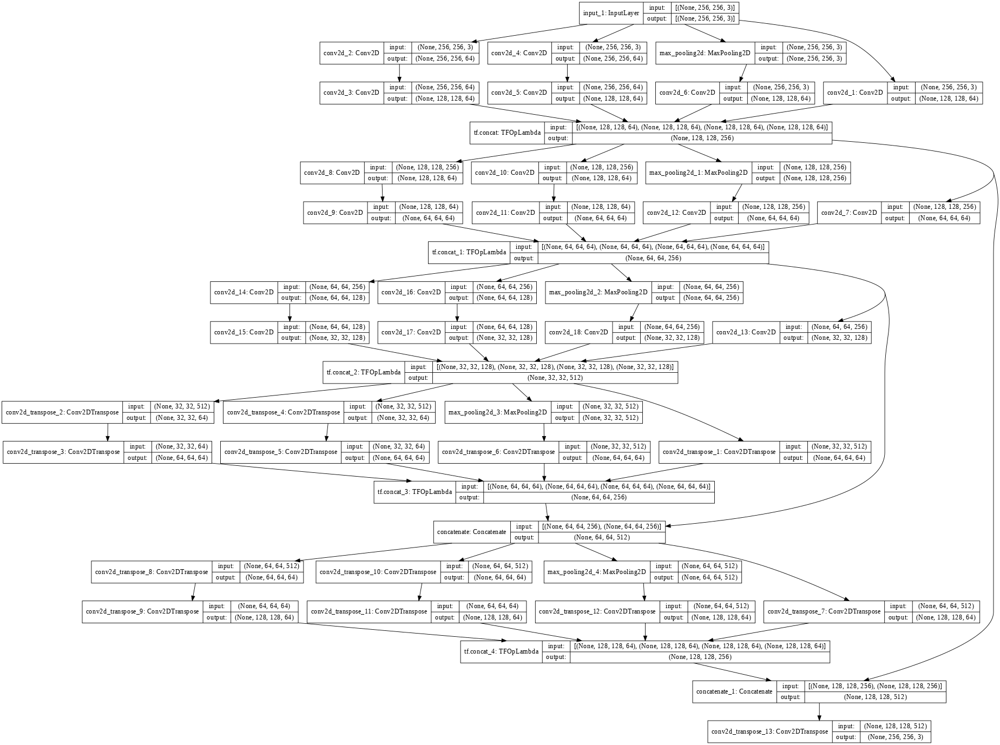

In [27]:
generator = Generator()
tf.keras.utils.plot_model(generator, show_shapes=True, dpi=64)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


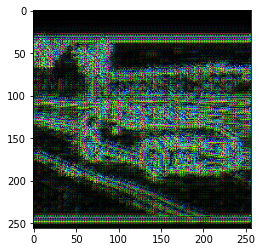

In [28]:
tmp_inp, tmp_re = random_jitter(inp, re)
gen_output = generator(tmp_inp[tf.newaxis, ...], training=False)
plt.imshow(gen_output[0, ...])

In [29]:
loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [30]:
LAMBDA = 100
def generator_loss(disc_generated_output, gen_output, target):
  gan_loss = loss_object(tf.ones_like(disc_generated_output), disc_generated_output)

  l1_loss = tf.reduce_mean(tf.abs(target - gen_output))
  total_gen_loss = gan_loss + (LAMBDA * l1_loss)

  return total_gen_loss, gan_loss, l1_loss

In [31]:
def Discriminator():
  initializer = tf.random_normal_initializer(0.0, 0.02)

  inp = tf.keras.layers.Input(shape=[256, 256, 3], name='input_image')
  tar = tf.keras.layers.Input(shape=[256, 256, 3], name='target_image')

  x = tf.keras.layers.concatenate([inp, tar])

  down1 = downsample(64, 4, False)(x)
  down2 = downsample(128, 4)(down1)
  down3 = downsample(256, 4)(down2)

  zero_pad1 = tf.keras.layers.ZeroPadding2D()(down3)
  conv = tf.keras.layers.Conv2D(512, 4, strides=1, kernel_initializer=initializer, use_bias=False)(zero_pad1)

  batchnorm1 = tf.keras.layers.BatchNormalization()(conv)
  leaky_relu = tf.keras.layers.LeakyReLU()(batchnorm1)
  zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu)
  last = tf.keras.layers.Conv2D(1, 4, strides=1, kernel_initializer=initializer)(zero_pad2)

  return tf.keras.Model(inputs=[inp, tar], outputs=last)

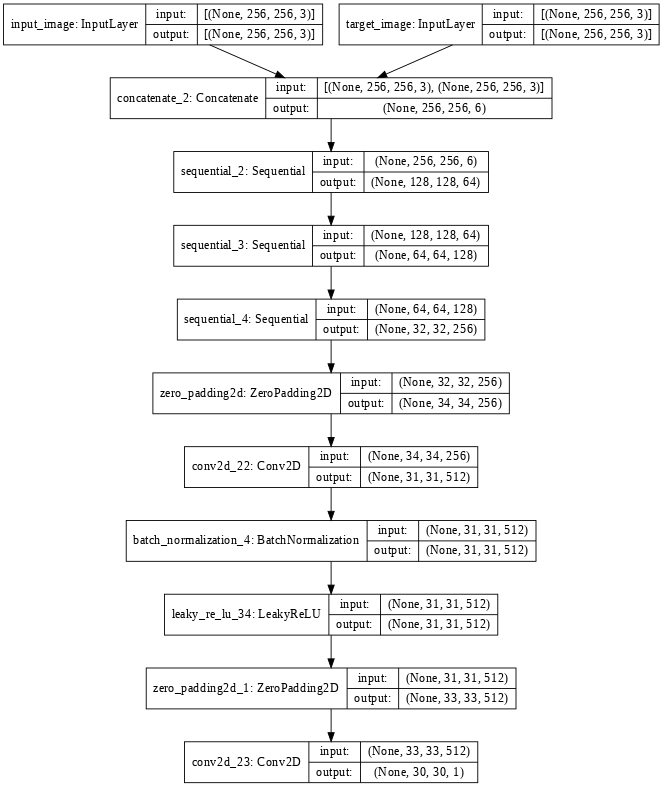

In [32]:
discriminator = Discriminator()
tf.keras.utils.plot_model(discriminator, show_shapes=True, dpi=64)

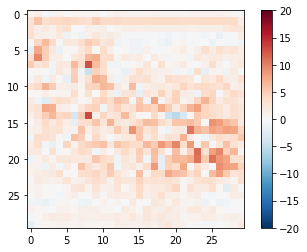

In [33]:
disc_out = discriminator([tmp_inp[tf.newaxis, ...], gen_output], training=False)
plt.imshow(disc_out[0, ..., -1], vmin=-20, vmax=20, cmap='RdBu_r')
plt.colorbar()

In [34]:
def discriminator_loss(disc_real_output, disc_generated_output):
  real_loss = loss_object(tf.ones_like(disc_real_output), disc_real_output)
  generated_loss = loss_object(tf.zeros_like(disc_generated_output), disc_generated_output)

  total_disc_loss = real_loss + generated_loss
  return total_disc_loss 

In [35]:
generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

In [36]:
def generate_images(model, test_input, tar):
  prediction = model(test_input, training=True)
  plt.figure(figsize=(15, 15))

  display_list = [test_input[0], tar[0], prediction[0]]
  title = ['Input Image', 'Ground Truth', 'Predicted Image']

  for i in range(3):
    plt.subplot(1, 3, i+1)
    plt.title(title[i])

    plt.imshow(display_list[i] * 0.5 + 0.5)
    plt.axis('off')

  plt.show()

In [37]:
train_dataset = tf.data.Dataset.list_files(original_dir + '*.jpg')
train_dataset = train_dataset.map(load_image_train, num_parallel_calls=tf.data.AUTOTUNE)
train_dataset = train_dataset.shuffle(BUFFER_SIZE)
train_dataset = train_dataset.batch(BATCH_SIZE)


/usr/local/lib/python3.7/dist-packages/tensorflow/python/data/ops/dataset_ops.py:3704: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable.debug_mode()`.
  "Even though the `tf.config.experimental_run_functions_eagerly` "


In [38]:
test_dataset = tf.data.Dataset.list_files(original_test_dir + '*.jpg')
test_dataset = test_dataset.map(load_image_test)
test_dataset = test_dataset.batch(BATCH_SIZE)

/usr/local/lib/python3.7/dist-packages/tensorflow/python/data/ops/dataset_ops.py:3704: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable.debug_mode()`.
  "Even though the `tf.config.experimental_run_functions_eagerly` "


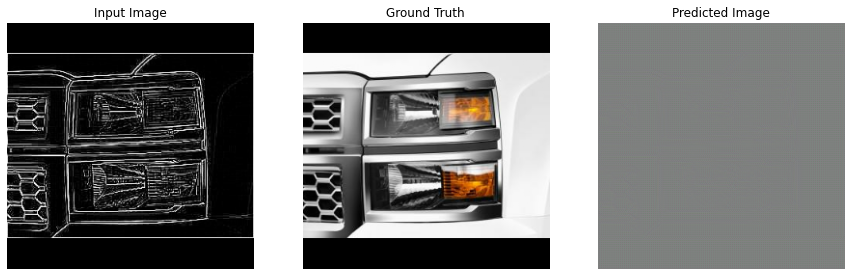

In [39]:
for example_input, example_target in test_dataset.take(1):
  generate_images(generator, example_input, example_target)

In [40]:
import datetime
log_dir = '/content/drive/MyDrive/logs_inception/'
summary_writer = tf.summary.create_file_writer(
    log_dir + 'fit/' + datetime.datetime.now().strftime('%Y%m%d-%H%M%S')
)

In [41]:
@tf.function
def train_step(input_image, target, epoch):
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    gen_output = generator(input_image, training=True)

    disc_real_output = discriminator([input_image, target], training=True)
    disc_generated_output = discriminator([input_image, gen_output], training=True)

    gen_total_loss, gen_gan_loss, gen_l1_loss = generator_loss(disc_generated_output, gen_output, target)
    disc_loss = discriminator_loss(disc_real_output, disc_generated_output)

  generator_gradients = gen_tape.gradient(gen_total_loss, generator.trainable_variables)
  discriminator_gradients = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(generator_gradients, generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(discriminator_gradients, discriminator.trainable_variables))

  with summary_writer.as_default():
    tf.summary.scalar('gen_total_loss', gen_total_loss, step=epoch)
    tf.summary.scalar('gen_gan_loss', gen_gan_loss, step=epoch)
    tf.summary.scalar('gen_l1_loss', gen_l1_loss, step=epoch)
    tf.summary.scalar('disc_loss', disc_loss, step=epoch)

In [42]:
checkpoint_dir = drive_dir + 'training_checkpoints_inception/'
checkpoint_prefix = os.path.join(checkpoint_dir, 'ckpt')
print(checkpoint_prefix)
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer, discriminator_optimizer=discriminator_optimizer, generator=generator, discriminator=discriminator)

/content/drive/MyDrive/training_checkpoints_inception/ckpt


In [43]:
def fit(train_ds, epochs, test_ds):
  for epoch in range(epochs):
    start = time.time()

    # train
    for n, (input_image, target) in train_ds.enumerate():

      if (n+1) % 100 == 0:
        display.clear_output(wait=True)
        print('Epoch: ', epoch)

        for example_input, example_target in test_ds.take(1):
          generate_images(generator, example_input, example_target)

        print(n)

      train_step(input_image, target, epoch)

      if (n + 1) % 20000 == 0:
        print('save checkpoint')
        checkpoint.save(file_prefix=checkpoint_prefix)

    print('save checkpoint')
    checkpoint.save(file_prefix=checkpoint_prefix)

    print('Time taken for epoch {} is {} sec\n'.format(epoch + 1, time.time() - start))


In [ ]:
!pip install -U tensorboard

Requirement already up-to-date: tensorboard in /usr/local/lib/python3.7/dist-packages (2.5.0)


In [ ]:
%reload_ext tensorboard
%tensorboard --logdir {log_dir}

Output hidden; open in https://colab.research.google.com to view.

Epoch:  0


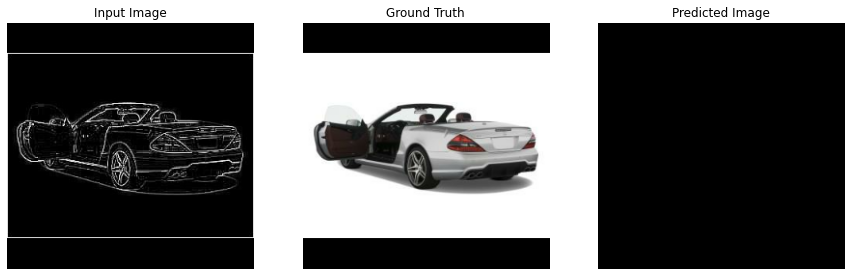

tf.Tensor(199, shape=(), dtype=int64)


KeyboardInterrupt: ignored

In [ ]:
EPOCHS = 10
fit(train_dataset, EPOCHS, test_dataset)

In [44]:
checkpoint.restore('/content/drive/MyDrive/training_checkpoints_inception/ckpt-2')

In [ ]:
!ls {checkpoint_dir}

checkpoint		     ckpt-20.data-00000-of-00001
ckpt-10.data-00000-of-00001  ckpt-20.index
ckpt-10.index		     ckpt-21.data-00000-of-00001
ckpt-11.data-00000-of-00001  ckpt-21.index
ckpt-11.index		     ckpt-22.data-00000-of-00001
ckpt-12.data-00000-of-00001  ckpt-22.index
ckpt-12.index		     ckpt-2.data-00000-of-00001
ckpt-13.data-00000-of-00001  ckpt-2.index
ckpt-13.index		     ckpt-3.data-00000-of-00001
ckpt-14.data-00000-of-00001  ckpt-3.index
ckpt-14.index		     ckpt-4.data-00000-of-00001
ckpt-15.data-00000-of-00001  ckpt-4.index
ckpt-15.index		     ckpt-5.data-00000-of-00001
ckpt-16.data-00000-of-00001  ckpt-5.index
ckpt-16.index		     ckpt-6.data-00000-of-00001
ckpt-17.data-00000-of-00001  ckpt-6.index
ckpt-17.index		     ckpt-7.data-00000-of-00001
ckpt-18.data-00000-of-00001  ckpt-7.index
ckpt-18.index		     ckpt-8.data-00000-of-00001
ckpt-19.data-00000-of-00001  ckpt-8.index
ckpt-19.index		     ckpt-9.data-00000-of-00001
ckpt-1.data-00000-of-00001   ckpt-9.index
ckpt-1.index


In [49]:
import hashlib
def save_generate_images(model, test_input, tar):
  prediction = model(test_input, training=True)
  plt.figure(figsize=(15, 15))

  display_list = [test_input[0], tar[0], prediction[0]]
  title = ['Input Image', 'Ground Truth', 'Predicted Image']

  for i in range(3):
    plt.subplot(1, 3, i+1)
    plt.title(title[i])

    plt.imshow(display_list[i] * 0.5 + 0.5)
    plt.axis('off')
  
  md5 = hashlib.md5()
  md5.update(test_input[0])
  name = md5.hexdigest()
  plt.savefig(drive_dir + 'car_fig_inception/' + name + '.png')

In [ ]:
for inp, tar in test_dataset:
  save_generate_images(generator, inp, tar)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


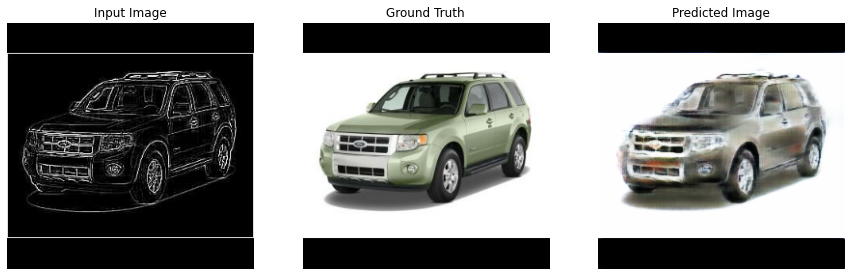

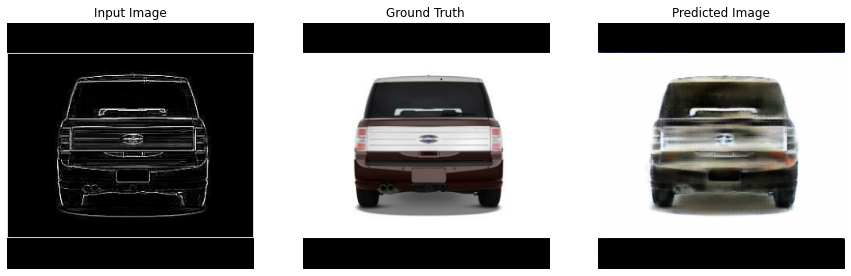

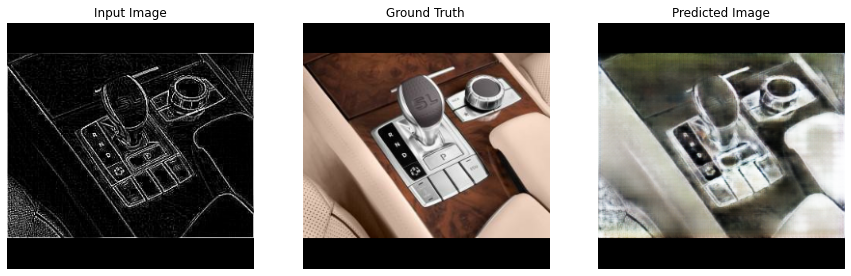

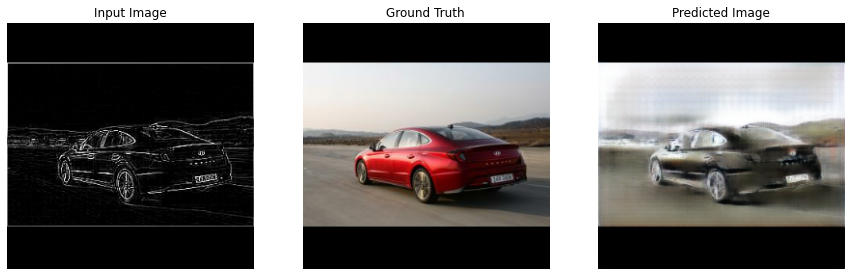

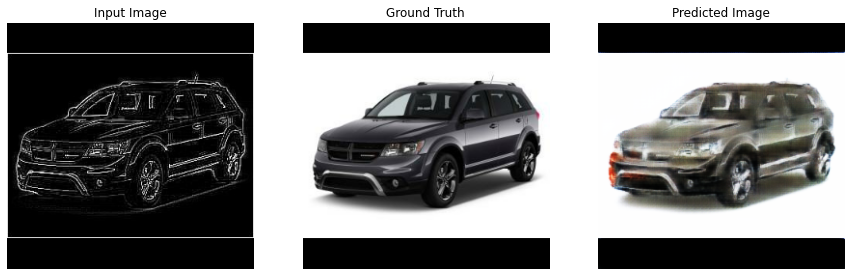

...

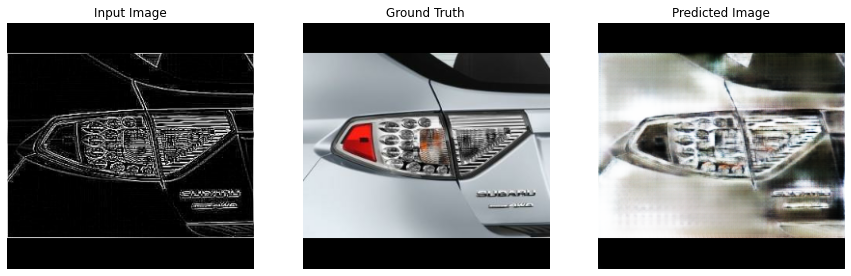

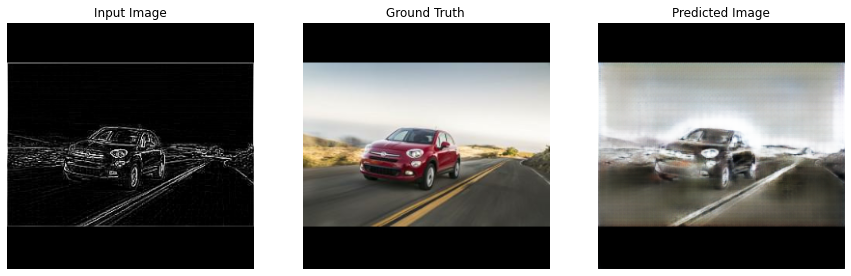

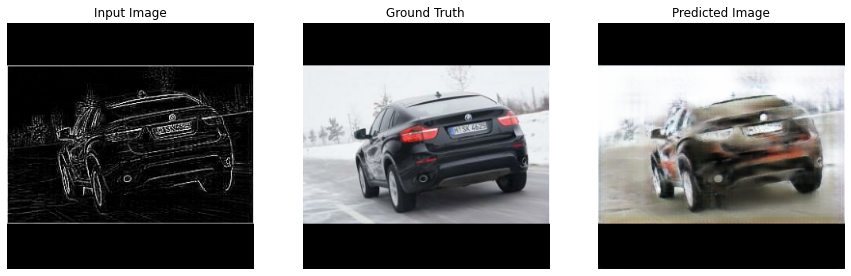

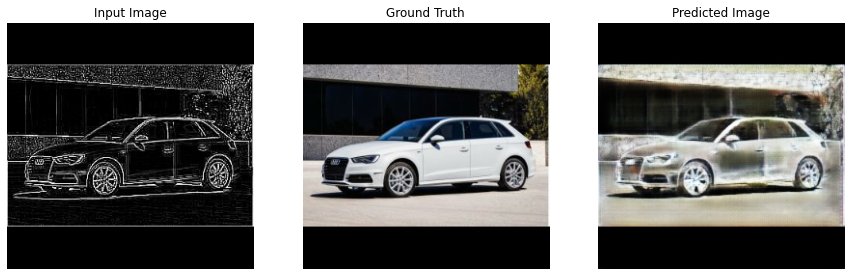

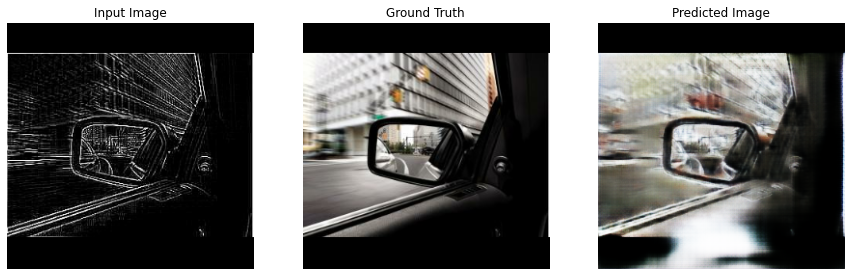

In [ ]:
for inp, tar in test_dataset.take(100):
  generate_images(generator, inp, tar)

In [ ]:
inception_model = tf.keras.applications.InceptionV3(include_top=False, weights='imagenet', pooling='avg')

In [ ]:
def compute_embeddings_real(dataloader, count):
  image_embeddings = []

  for _ in tqdm.tqdm(range(count)):
    images = next(iter(dataloader))[1]
    embeddings = inception_model.predict(images)
    image_embeddings.extend(embeddings)

  return np.array(image_embeddings)



In [ ]:
def compute_embeddings_gen(dataloader, count):
  image_embeddings = []

  for _ in tqdm.tqdm(range(count)):
    images = next(iter(dataloader))[0]
    gen_output = generator(images, training=True)
    embeddings = inception_model.predict(gen_output)
    image_embeddings.extend(embeddings)

  return np.array(image_embeddings)


In [ ]:
count = 1000

real_image_embeddings = compute_embeddings_real(test_dataset, count)


print(real_image_embeddings.shape)

  0%|          | 0/1000 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/tensorflow/python/data/ops/dataset_ops.py:3704: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable.debug_mode()`.
  "Even though the `tf.config.experimental_run_functions_eagerly` "
100%|██████████| 1000/1000 [03:47<00:00,  4.39it/s]

(1000, 2048)


In [ ]:
generated_image_embeddings = compute_embeddings_gen(test_dataset, count)
print(generated_image_embeddings.shape)

  0%|          | 0/1000 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/tensorflow/python/data/ops/dataset_ops.py:3704: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable.debug_mode()`.
  "Even though the `tf.config.experimental_run_functions_eagerly` "
100%|██████████| 1000/1000 [04:14<00:00,  3.93it/s]

(1000, 2048)


In [ ]:
def calculate_fid(real_embeddings, generated_embeddings):
  mu1, sigma1 = real_embeddings.mean(axis=0), np.cov(real_embeddings, rowvar=False)
  # print('~~~~~ mu1: {}'.format(mu1))
  # print('~~~~~ sigma1: {}'.format(sigma1))

  mu2, sigma2 = generated_embeddings.mean(axis=0), np.cov(generated_embeddings, rowvar=False)
  # print('~~~~~ mu2: {}'.format(mu2))
  # print('~~~~~ sigma2: {}'.format(sigma2))

  ssdiff = np.sum((mu1 - mu2) ** 2.0)
  # print('~~~~~ ssdiff: {}'.format(ssdiff))

  sigma = sigma1.dot(sigma2)
  # print('~~~~~ sigma: {}'.format(sigma.shape))
  covmean = sqrtm(sigma)
  # print('~~~~~ covmean: {}'.format(covmean))

  if np.iscomplexobj(covmean):
    covmean = covmean.real

  fid = ssdiff + np.trace(sigma1 + sigma2 - 2.0 * covmean)

  return fid
  

In [ ]:
print(real_image_embeddings.shape)
print(generated_image_embeddings.shape)

print(real_image_embeddings.mean())
print(real_image_embeddings.var())

print(generated_image_embeddings.mean())
print(generated_image_embeddings.var())

(1000, 2048)
(1000, 2048)
0.37093493
0.16043043
0.38858297
0.1601957


In [ ]:
fid = calculate_fid(real_image_embeddings, generated_image_embeddings)

print(fid)

196.73393898748856
